# Camera Calibration

In [93]:
import sys
sys.path.append('/usr/local/lib/python2.7/site-packages')
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from scipy.signal import find_peaks_cwt
%matplotlib inline

In [94]:
# prepare object points
nx = 9 # The number of inside corners in x
ny = 6 # The number of inside corners in y

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((nx*ny,3), np.float32)
objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.


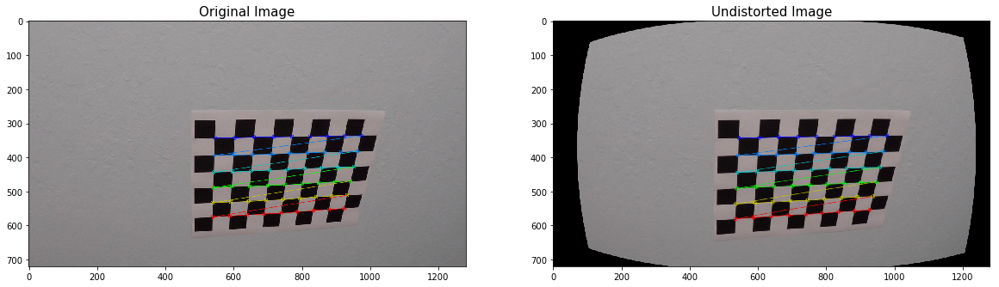

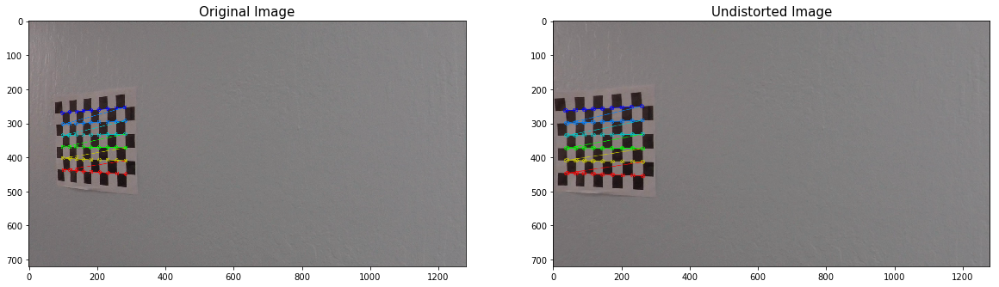

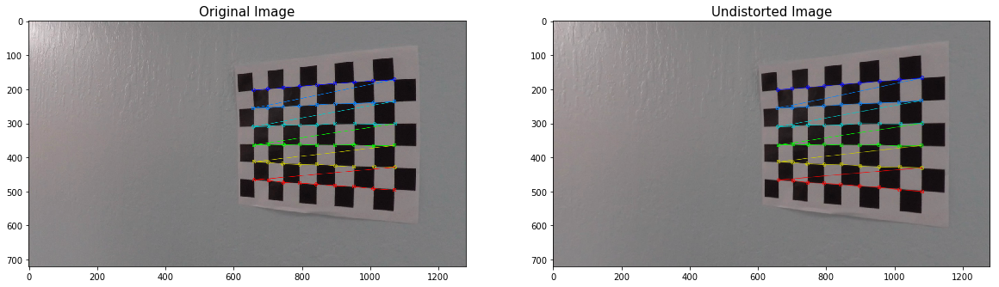

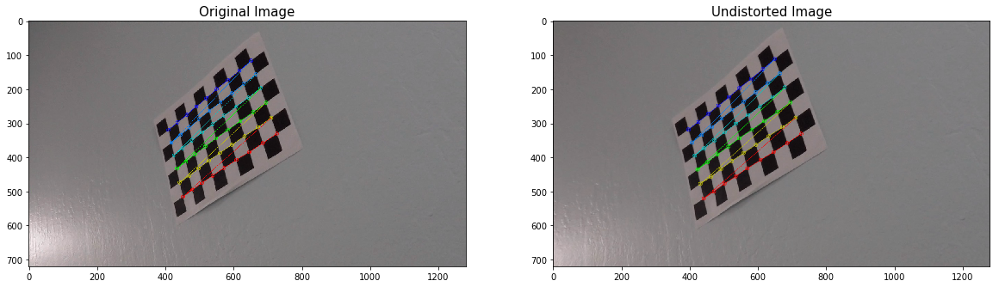

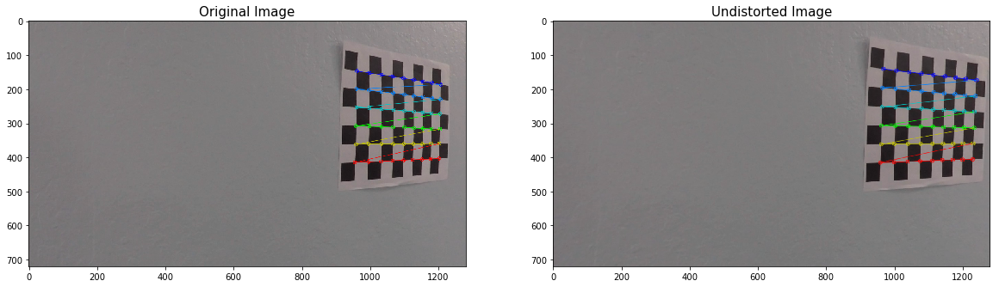

...

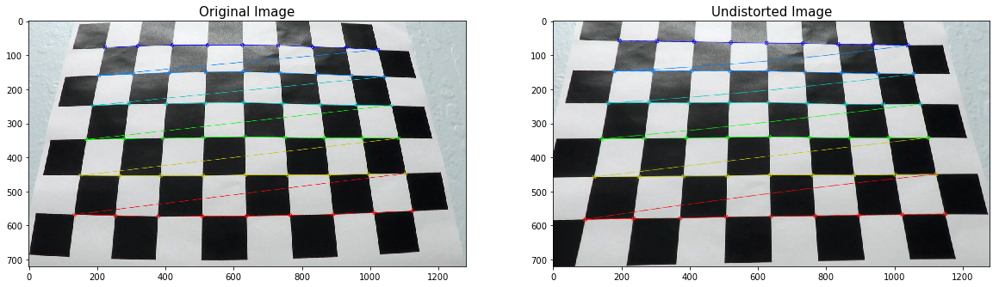

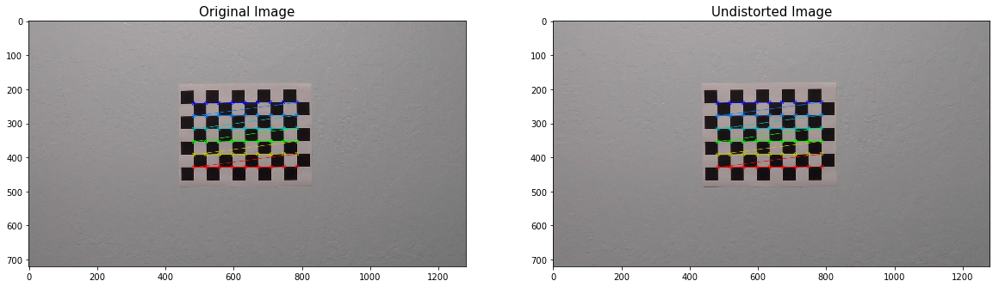

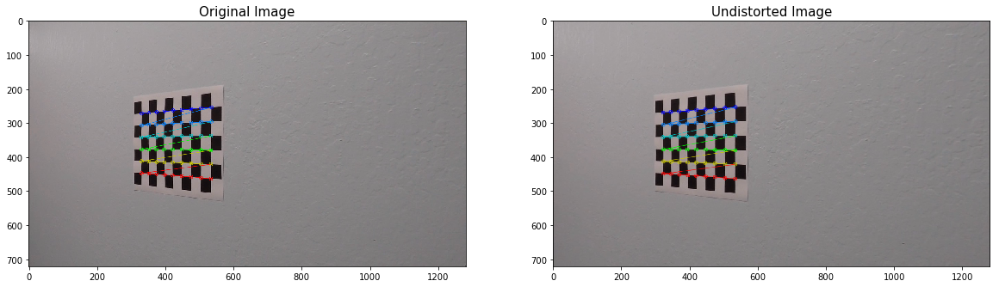

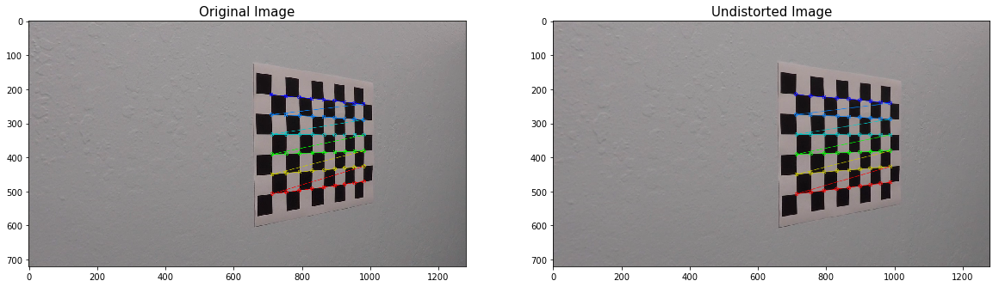

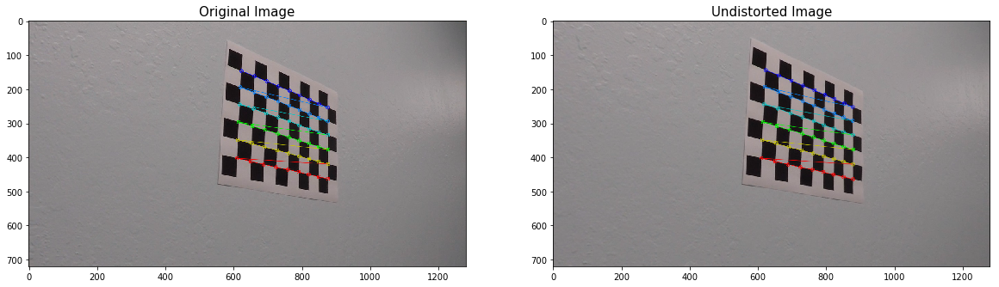

In [95]:
paths = glob.glob('camera_cal/calibration*.jpg')

for path in paths:
    fname = path;
    img = cv2.imread(fname)
    img_size = (img.shape[1], img.shape[0])
    #convert the image to grey scale 
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    #calculate the corners 
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)
    
    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
        # Do camera calibration given object points and image points
        ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)
        dst = cv2.undistort(img, mtx, dist, None, mtx)
        cv2.imwrite('calibration_wide/test_undist.jpg',dst)
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
        ax1.imshow(img)
        ax1.set_title('Original Image', fontsize=15)
        ax2.imshow(dst)
        ax2.set_title('Undistorted Image', fontsize=15)

In [96]:
def corners_unwarp(img, nx, ny, mtx, dist):
    img = cv2.resize(img, (720, 405))
    # 1) Undistort using mtx and dist
    img = cv2.undistort(img, mtx, dist, None, mtx)
    apex, apey = 360, 258
    offset_far = 50
    offset_near = 10
    src = np.float32([[int(apex-offset_far),apey],
                      [int(apex+offset_far),apey],
                      [int(0+offset_near),390],
                      [int(720-offset_near),390]])
    dst = np.float32([[0,0],[720,0],[0,405],[720,405]])
    perspective_M = cv2.getPerspectiveTransform(src, dst)
    top_down = cv2.warpPerspective(img,  perspective_M, (img.shape[1], img.shape[0]), flags=cv2.INTER_LINEAR)
    return top_down,perspective_M

In [97]:
def corners_warp(img):
    img = cv2.resize(img, (720, 405))
    # 1) Undistort using mtx and dist
    img = cv2.undistort(img, mtx, dist, None, mtx)
    apex, apey = 360, 258
    offset_far = 50
    offset_near = 10
    dst = np.float32([[int(apex-offset_far),apey],
                      [int(apex+offset_far),apey],
                      [int(0+offset_near),390],
                      [int(720-offset_near),390]])
    src = np.float32([[0,0],[720,0],[0,405],[720,405]])
    perspective_M = cv2.getPerspectiveTransform(src, dst)
    top_down = cv2.warpPerspective(img,  perspective_M, (img.shape[1], img.shape[0]), flags=cv2.INTER_LINEAR)
    return top_down,perspective_M

In [98]:
# Calculate directional gradient
def abs_sobel_thresh(gray, orient='x', ksize=3, thresh=(0, 255)):
    # Apply x or y gradient
    if orient == 'x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=ksize)
    elif orient == 'y':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=ksize)
    # Take the absolute values
    sobel = np.absolute(sobel)
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*sobel/np.max(sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel > thresh[0]) & (scaled_sobel < thresh[1])] = 1
    # Return the result
    return binary_output

In [99]:
# Edit this function to create your own pipeline.
def pipeline(img): 
    img = cv2.resize(img, (720, 405))
    # Convert to HLS color space and separate the S channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    # Grayscale image
    # NOTE: we already saw that standard grayscaling lost color information for the lane lines
    # Explore gradients in other colors spaces / color channels to see what might work better
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # Sobel x
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))

    # Threshold x gradient
    thresh_min = 20
    thresh_max = 100
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1

    # Threshold color channel
    s_thresh_min = 170
    s_thresh_max = 255
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh_min) & (s_channel <= s_thresh_max)] = 1

    # Stack each channel to view their individual contributions in green and blue respectively
    # This returns a stack of the two binary images, whose components you can see as different colors
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary))

    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1
    return combined_binary

In [100]:
def make_histogram(unwarped):
    # Assuming you have created a warped binary image called "combined"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(unwarped[unwarped.shape[0]/2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((unwarped, unwarped, unwarped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    #print(leftx_base, rightx_base)
    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(unwarped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = unwarped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 80
    # Set minimum number of pixels found to recenter window
    minpix = 40
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = unwarped.shape[0] - np.int((window+1)*window_height)
        win_y_high = unwarped.shape[0] - np.int(window*window_height)
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    return leftx, lefty, rightx, righty, out_img

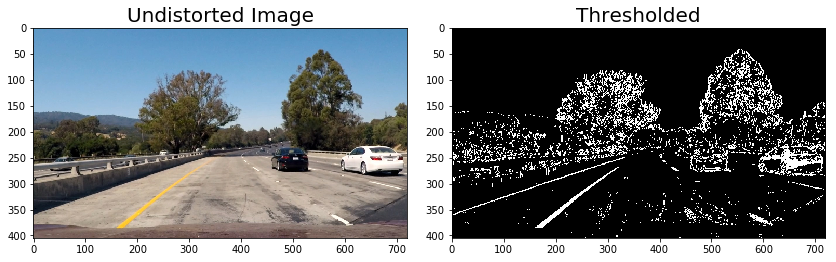

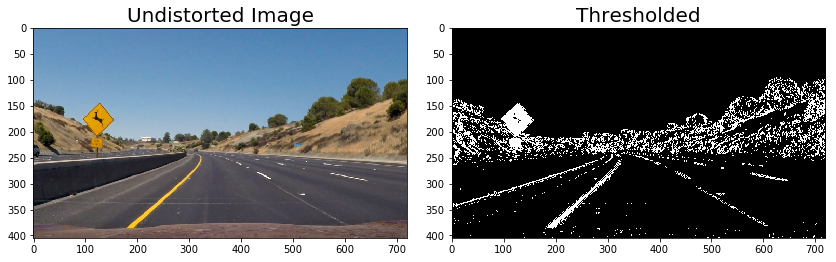

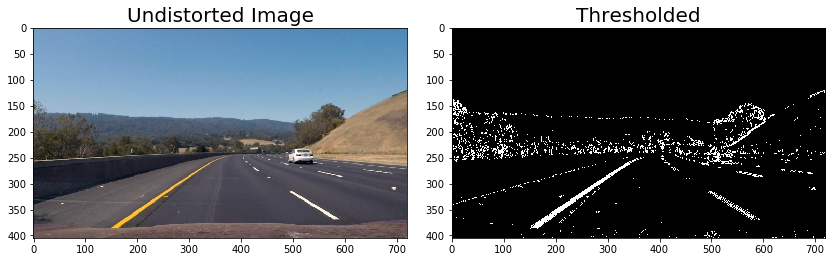

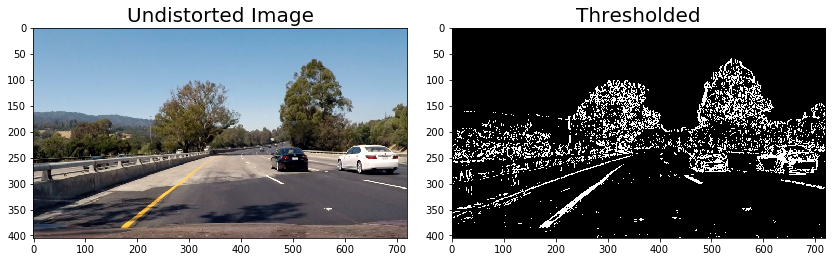

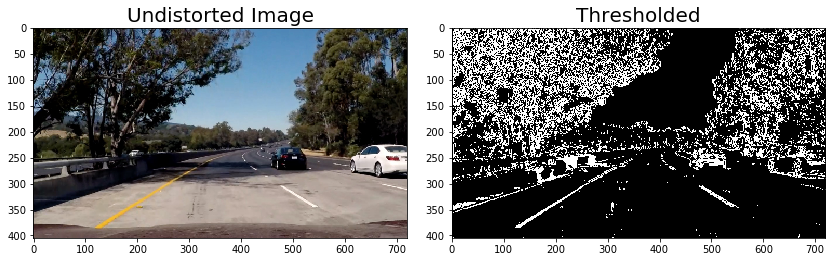

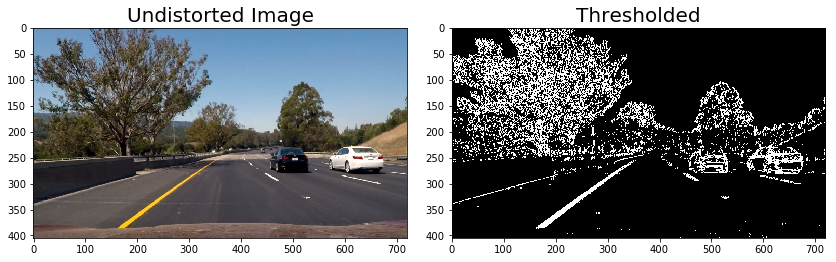

In [101]:
paths = glob.glob('test_images/test*.jpg')

for path in paths:
    img = plt.imread(path)
    img = cv2.resize(img, (720, 405))
    thresholded = pipeline(img)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(11, 5))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Undistorted Image', fontsize=20)
    ax2.imshow(thresholded,cmap='gray' )
    ax2.set_title('Thresholded', fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [102]:
def find_3p_circle_radius(x1,y1,x2,y2,x3,y3):
    
    # source : http://www.intmath.com/applications-differentiation/8-radius-curvature.php
    m1 = (y2-y1)/(x2-x1)
    m2 = (y3-y2)/(x3-x2)
    
    xc = (m1*m2*(y1-y3)+m2*(x1+x2)-m1*(x2+x3))/(2*(m2-m1))
    yc = -(xc-(x1+x2)/2)/m1+(y1+y2)/2
    
    Radius = np.sqrt((x2-xc)*(x2-xc)+(y2-yc)*(y2-yc))
    
    return m1, m2, xc, yc, Radius

In [103]:
def calculate_curvature(leftx, lefty, rightx, righty, out_img, yvals,combined):
    
    # Fit a second order polynomial to each lane line
    left_fit = np.polyfit(lefty, leftx, 2)
    left_fitx = left_fit[0]*yvals**2 + left_fit[1]*yvals + left_fit[2]
    right_fit = np.polyfit(righty, rightx, 2)
    right_fitx = right_fit[0]*yvals**2 + right_fit[1]*yvals + right_fit[2]

    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/405 # meters per pixel in y dimension
    xm_per_pix = 3.7/500 # meteres per pixel in x dimension
    # Define y-value where we want radius of curvature
    # I'll choose 3 y-values(max, mean and min):
    y_eval = np.max(yvals)
    
    y_eval1 = np.max(yvals)
    y_eval2 = np.mean(yvals)
    y_eval3 = np.min(yvals)
    left_fitx_1 = left_fit[0]*y_eval1**2 + left_fit[1]*yvals + left_fit[2]
    left_fitx_2 = left_fit[0]*y_eval2**2 + left_fit[1]*yvals + left_fit[2]
    left_fitx_3 = left_fit[0]*y_eval3**2 + left_fit[1]*yvals + left_fit[2]
    right_fitx_1 = right_fit[0]*y_eval1**2 + right_fit[1]*yvals + right_fit[2]
    right_fitx_2 = right_fit[0]*y_eval2**2 + right_fit[1]*yvals + right_fit[2]
    right_fitx_3 = right_fit[0]*y_eval3**2 + right_fit[1]*yvals + right_fit[2]
     
    lm1, lm2, lxc, lyc, lradius = find_3p_circle_radius(left_fitx_1,y_eval1,left_fitx_2,y_eval2,left_fitx_3,y_eval3,)
    l_steering_angle = 5*360/lxc # assume xc <> 0, xc and radius value is very close, xc will show the direction as well
    
    
    rm1, rm2, rxc, ryc, rradius = find_3p_circle_radius(right_fitx_1,y_eval1,right_fitx_2,y_eval2,right_fitx_3,y_eval3,)
    r_steering_angle = 5*360/rxc # assume xc <> 0, xc and radius value is very close, xc will show the direction as well
   
    
    steering_angle = l_steering_angle + r_steering_angle
    turning_radius = (lradius+rradius)/2 # smooth out the radius
   
    # Find camera position
    left_mean = np.mean(leftx)
    right_mean = np.mean(rightx)
    camera_pos = (combined.shape[1]/2)-np.mean([left_mean, right_mean])
    lefty = (np.array(lefty,dtype=np.float32)*30)/405
    leftx = (np.array(lefty,dtype=np.float32)*30)/405
    righty = (np.array(lefty,dtype=np.float32)*3.7)/500
    rightx = (np.array(lefty,dtype=np.float32)*3.7)/500
   
    left_fit_cr =  np.polyfit(lefty,leftx , 2)
    right_fit_cr =  np.polyfit(righty,rightx , 2)
    
    # Return radius of curvature is in meters
    
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval + left_fit_cr[1])**2)**1.5) \
                             /np.absolute(2*left_fit_cr[0])

    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval + right_fit_cr[1])**2)**1.5) \
                                /np.absolute(2*right_fit_cr[0])
    return left_curverad, right_curverad,camera_pos,steering_angle,turning_radius
      

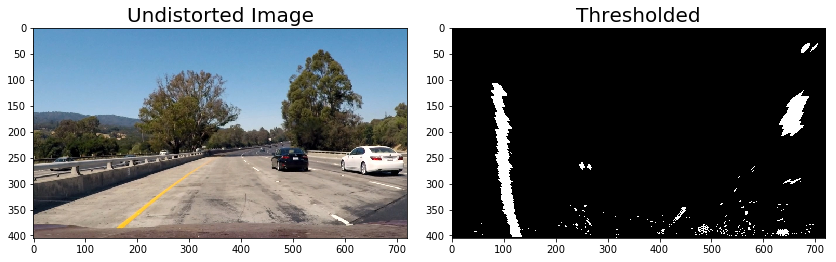

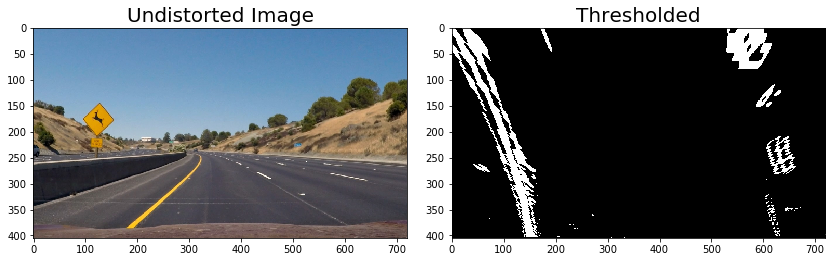

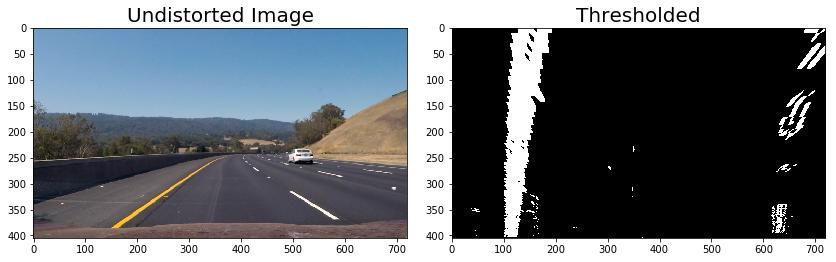

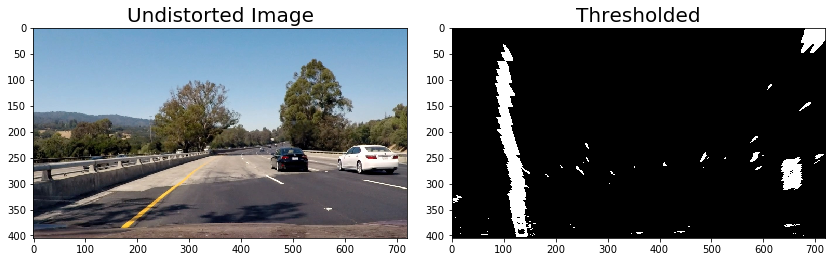

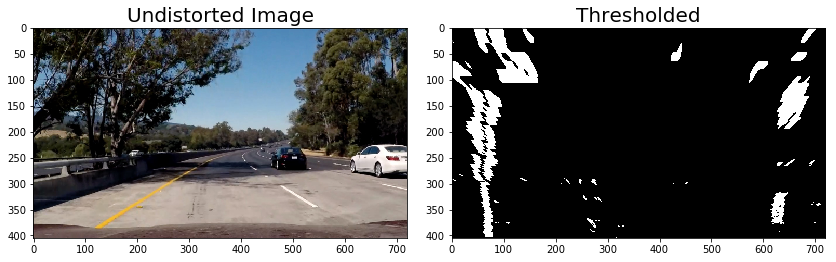

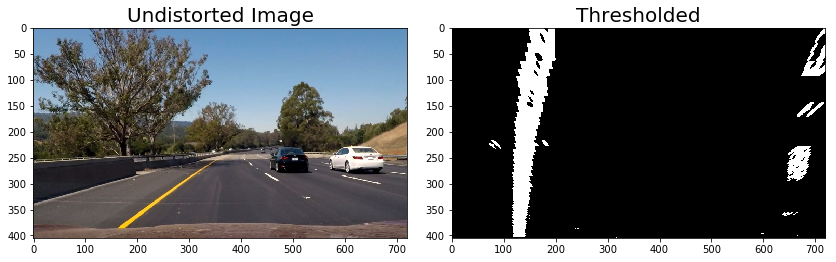

In [104]:
paths = glob.glob('test_images/test*.jpg')

for path in paths:
    img = plt.imread(path)
    img = cv2.resize(img, (720, 405))
    thresholded = pipeline(img)
    warped, perspective_M = corners_unwarp(thresholded, nx, ny, mtx, dist)
    leftx, lefty, rightx, righty, out_img  = make_histogram(warped)
    ploty = np.linspace(0, img.shape[0], num=img.shape[0])
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(11, 5))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Undistorted Image', fontsize=20)
    ax2.imshow( warped,cmap='gray' )
    ax2.set_title('Thresholded', fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


In [105]:
# Create an image to draw the lines on
def overlay_lane(img,top_down,left_fitx,right_fitx,ploty): 
    warp_zero = np.zeros_like(top_down).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    newwarp,perspective_M = corners_warp(color_warp) 
    # Combine the result with the original image
    result = cv2.addWeighted(img, 1, newwarp, 0.3, 0)
    return result;

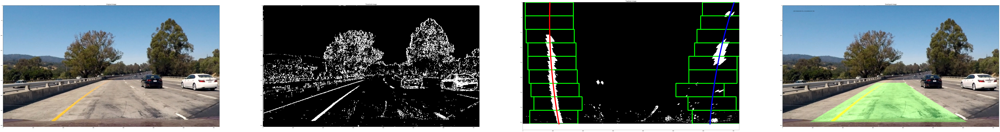

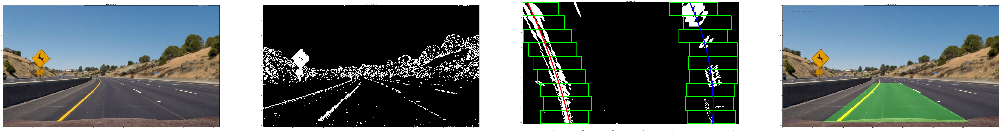

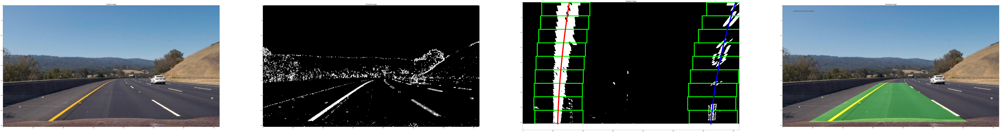

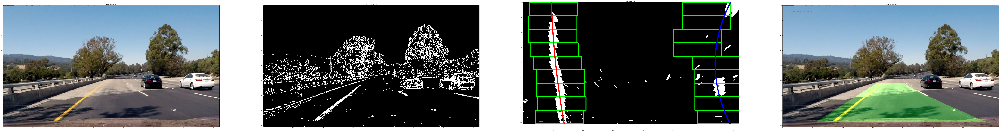

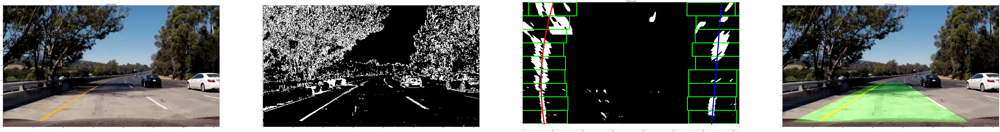

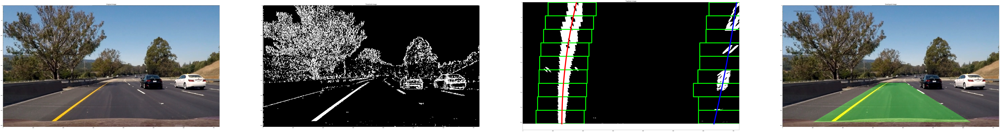

In [106]:
paths = glob.glob('test_images/test*.jpg')

for path in paths:
    img = plt.imread(path)
    img = cv2.resize(img, (720, 405))
    thresholded = pipeline(img)
    unwarped, perspective_M = corners_unwarp(thresholded, nx, ny, mtx, dist)
    leftx, lefty, rightx, righty, out_img  = make_histogram(unwarped)
    ploty = np.linspace(0, img.shape[0], num=img.shape[0])
    left_curverad, right_curverad,camera_pos,steering_angle,turning_radius = calculate_curvature(leftx, lefty, rightx, righty, out_img, ploty,thresholded)
    # Fit a second order polynomial to each lane line
    left_fit = np.polyfit(lefty, leftx, 2)
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fit = np.polyfit(righty, rightx, 2)
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    result = overlay_lane(img,unwarped,left_fitx,right_fitx,ploty)
    f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(200,100))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=15)
    ax2.imshow(thresholded,cmap='gray')
    ax2.set_title('Threshold image', fontsize=15)
    ax3.imshow(out_img ,cmap='gray')
    ax3.set_title('Topdown image', fontsize=15)
    ax3.plot(left_fitx, ploty, color='red',linewidth=13)
    ax3.plot(right_fitx, ploty, color='blue',linewidth=13)
    ax4.imshow(result ,cmap='gray')
    ax4.set_title('Overlayed image', fontsize=15)
    ax4.annotate((left_curverad, right_curverad), xy=(0.05, 0.95), xycoords='axes fraction')

In [ ]:
ym_per_pix = 30/405 # meters per pixel in y dimension
xm_per_pix = 3.7/500 # meteres per pixel in x dimension

def process_video(img):
    img = plt.imread(path)
    img = cv2.resize(img, (720, 405))
    thresholded = pipeline(img)
    unwarped, perspective_M = corners_unwarp(thresholded, nx, ny, mtx, dist)
    leftx, lefty, rightx, righty, out_img  = make_histogram(unwarped)
    ploty = np.linspace(0, img.shape[0], num=img.shape[0])
    left_curverad, right_curverad,camera_pos,steering_angle,turning_radius = calculate_curvature(leftx, lefty, rightx, righty, out_img, ploty,thresholded)
    # Fit a second order polynomial to each lane line
    left_fit = np.polyfit(lefty, leftx, 2)
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fit = np.polyfit(righty, rightx, 2)
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    result = overlay_lane(img,unwarped,left_fitx,right_fitx,ploty)
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(result,'Left curve radius '+'{:.4}'.format(str(left_curverad)) + 'm',(10,90), font, 1,(255,255,255),2)
    cv2.putText(result,'Right curve radius '+'{:.4}'.format(str(right_curverad)) + 'm',(10,120), font, 1,(255,255,255),2)
    cv2.putText(img,'Turning Radius ' +str(turning_radius)[:6] + '] m' ,(10,240), font, 1,(255,255,255),2)
    cv2.putText(img,'Steering Angle '+'{:.6}'.format(str(steering_angle)) + '] deg',(10,300), font, 1,(255,255,255),2)
    return result


In [ ]:
from moviepy.editor import VideoFileClip
output = 'project_video_output1.mp4'
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(process_video)
%time white_clip.write_videofile(output, audio=False)

[MoviePy] >>>> Building video project_video_output1.mp4
[MoviePy] Writing video project_video_output1.mp4




  0%|          | 0/1261 [00:00<?, ?it/s]

  0%|          | 1/1261 [00:00<05:56,  3.53it/s]

  0%|          | 2/1261 [00:00<05:54,  3.55it/s]

  0%|          | 3/1261 [00:00<05:51,  3.57it/s]

  0%|          | 4/1261 [00:01<05:52,  3.56it/s]

  0%|          | 5/1261 [00:01<05:52,  3.56it/s]

  0%|          | 6/1261 [00:01<05:50,  3.58it/s]

  1%|          | 7/1261 [00:01<05:53,  3.55it/s]

  1%|          | 8/1261 [00:02<05:54,  3.54it/s]

  1%|          | 9/1261 [00:02<05:51,  3.56it/s]

  1%|          | 10/1261 [00:02<05:49,  3.58it/s]

  1%|          | 11/1261 [00:03<05:47,  3.60it/s]

  1%|          | 12/1261 [00:03<05:45,  3.62it/s]

  1%|          | 13/1261 [00:03<05:44,  3.63it/s]

  1%|          | 14/1261 [00:03<05:48,  3.58it/s]

  1%|          | 15/1261 [00:04<05:48,  3.58it/s]

  1%|▏         | 16/1261 [00:04<05:48,  3.57it/s]

  1%|▏         | 17/1261 [00:04<05:48,  3.57it/s]

  1%|▏         | 18/1261 [00:05<05:48,  3.57it/s]

  2%|▏         | 19/1261 [00:05<05:46,  3.58it/

 11%|█▏        | 143/1261 [00:40<05:16,  3.53it/s]

 11%|█▏        | 144/1261 [00:41<05:15,  3.54it/s]

 11%|█▏        | 145/1261 [00:41<05:13,  3.56it/s]

 12%|█▏        | 146/1261 [00:41<05:11,  3.58it/s]

 12%|█▏        | 147/1261 [00:41<05:11,  3.57it/s]

 12%|█▏        | 148/1261 [00:42<05:14,  3.54it/s]

 12%|█▏        | 149/1261 [00:42<05:15,  3.52it/s]

 12%|█▏        | 150/1261 [00:42<05:16,  3.51it/s]

 12%|█▏        | 151/1261 [00:43<05:17,  3.49it/s]

 12%|█▏        | 152/1261 [00:43<05:16,  3.50it/s]

 12%|█▏        | 153/1261 [00:43<05:17,  3.49it/s]

 12%|█▏        | 154/1261 [00:43<05:16,  3.50it/s]

 12%|█▏        | 155/1261 [00:44<05:14,  3.51it/s]

 12%|█▏        | 156/1261 [00:44<05:16,  3.50it/s]

 12%|█▏        | 157/1261 [00:44<05:13,  3.52it/s]

 13%|█▎        | 158/1261 [00:44<05:12,  3.53it/s]

 13%|█▎        | 159/1261 [00:45<05:11,  3.53it/s]

 13%|█▎        | 160/1261 [00:45<05:11,  3.53it/s]

 13%|█▎        | 161/1261 [00:45<05:11,  3.54it/s]

 13%|█▎     

 23%|██▎       | 284/1261 [01:20<04:32,  3.58it/s]

 23%|██▎       | 285/1261 [01:20<04:31,  3.60it/s]

 23%|██▎       | 286/1261 [01:21<04:30,  3.61it/s]

 23%|██▎       | 287/1261 [01:21<04:28,  3.63it/s]

 23%|██▎       | 288/1261 [01:21<04:31,  3.59it/s]

 23%|██▎       | 289/1261 [01:21<04:32,  3.56it/s]

 23%|██▎       | 290/1261 [01:22<04:33,  3.55it/s]

 23%|██▎       | 291/1261 [01:22<04:30,  3.59it/s]

 23%|██▎       | 292/1261 [01:22<04:29,  3.59it/s]

 23%|██▎       | 293/1261 [01:22<04:29,  3.59it/s]

 23%|██▎       | 294/1261 [01:23<04:31,  3.56it/s]

 23%|██▎       | 295/1261 [01:23<04:31,  3.56it/s]

 23%|██▎       | 296/1261 [01:23<04:31,  3.55it/s]

 24%|██▎       | 297/1261 [01:24<04:34,  3.51it/s]

 24%|██▎       | 298/1261 [01:24<04:34,  3.51it/s]

 24%|██▎       | 299/1261 [01:24<04:32,  3.54it/s]

 24%|██▍       | 300/1261 [01:24<04:31,  3.55it/s]

 24%|██▍       | 301/1261 [01:25<04:28,  3.58it/s]

 24%|██▍       | 302/1261 [01:25<04:26,  3.60it/s]

 24%|██▍    

 34%|███▎      | 425/1261 [02:01<04:15,  3.27it/s]

 34%|███▍      | 426/1261 [02:02<04:15,  3.26it/s]

 34%|███▍      | 427/1261 [02:02<04:12,  3.30it/s]

 34%|███▍      | 428/1261 [02:02<04:18,  3.22it/s]

 34%|███▍      | 429/1261 [02:03<04:25,  3.14it/s]

 34%|███▍      | 430/1261 [02:03<04:27,  3.11it/s]

 34%|███▍      | 431/1261 [02:03<04:39,  2.97it/s]

 34%|███▍      | 432/1261 [02:04<04:33,  3.03it/s]

 34%|███▍      | 433/1261 [02:04<04:25,  3.12it/s]

 34%|███▍      | 434/1261 [02:04<04:20,  3.18it/s]

 34%|███▍      | 435/1261 [02:05<04:13,  3.26it/s]

 35%|███▍      | 436/1261 [02:05<04:11,  3.28it/s]

 35%|███▍      | 437/1261 [02:05<04:10,  3.28it/s]

 35%|███▍      | 438/1261 [02:05<04:08,  3.31it/s]

 35%|███▍      | 439/1261 [02:06<04:09,  3.30it/s]

 35%|███▍      | 440/1261 [02:06<04:09,  3.29it/s]

 35%|███▍      | 441/1261 [02:06<04:06,  3.32it/s]

 35%|███▌      | 442/1261 [02:07<04:05,  3.34it/s]

 35%|███▌      | 443/1261 [02:07<04:04,  3.35it/s]

 35%|███▌   

 45%|████▍     | 566/1261 [03:29<33:23,  2.88s/it]

 45%|████▍     | 567/1261 [03:32<36:08,  3.13s/it]

 45%|████▌     | 568/1261 [03:35<33:21,  2.89s/it]

 45%|████▌     | 569/1261 [03:37<31:13,  2.71s/it]

 45%|████▌     | 570/1261 [03:39<30:24,  2.64s/it]

 45%|████▌     | 571/1261 [03:42<28:52,  2.51s/it]

 45%|████▌     | 572/1261 [03:43<25:35,  2.23s/it]

 45%|████▌     | 573/1261 [03:45<22:18,  1.95s/it]

 46%|████▌     | 574/1261 [03:46<19:34,  1.71s/it]

 46%|████▌     | 575/1261 [03:47<17:01,  1.49s/it]

 46%|████▌     | 576/1261 [03:48<15:15,  1.34s/it]

 46%|████▌     | 577/1261 [03:48<13:27,  1.18s/it]

 46%|████▌     | 578/1261 [03:49<11:56,  1.05s/it]

 46%|████▌     | 579/1261 [03:50<10:58,  1.04it/s]

 46%|████▌     | 580/1261 [03:51<10:17,  1.10it/s]

 46%|████▌     | 581/1261 [03:51<09:34,  1.18it/s]

 46%|████▌     | 582/1261 [03:52<09:07,  1.24it/s]

 46%|████▌     | 583/1261 [03:53<08:39,  1.30it/s]

 46%|████▋     | 584/1261 [03:53<08:18,  1.36it/s]

 46%|████▋  

 56%|█████▌    | 707/1261 [05:00<06:46,  1.36it/s]

 56%|█████▌    | 708/1261 [05:01<06:32,  1.41it/s]

 56%|█████▌    | 709/1261 [05:02<06:17,  1.46it/s]

 56%|█████▋    | 710/1261 [05:02<06:04,  1.51it/s]

 56%|█████▋    | 711/1261 [05:03<05:48,  1.58it/s]

 56%|█████▋    | 712/1261 [05:03<05:35,  1.64it/s]

 57%|█████▋    | 713/1261 [05:04<05:24,  1.69it/s]

 57%|█████▋    | 714/1261 [05:04<05:11,  1.76it/s]

 57%|█████▋    | 715/1261 [05:05<05:05,  1.79it/s]

 57%|█████▋    | 716/1261 [05:05<04:57,  1.83it/s]

 57%|█████▋    | 717/1261 [05:06<04:52,  1.86it/s]

 57%|█████▋    | 718/1261 [05:06<04:45,  1.90it/s]

 57%|█████▋    | 719/1261 [05:07<04:49,  1.87it/s]

 57%|█████▋    | 720/1261 [05:07<04:39,  1.93it/s]

 57%|█████▋    | 721/1261 [05:08<04:33,  1.98it/s]

 57%|█████▋    | 722/1261 [05:08<04:28,  2.01it/s]

 57%|█████▋    | 723/1261 [05:09<04:26,  2.02it/s]

 57%|█████▋    | 724/1261 [05:09<04:26,  2.02it/s]

 57%|█████▋    | 725/1261 [05:10<04:27,  2.00it/s]

 58%|█████▊ 

 67%|██████▋   | 848/1261 [06:12<02:25,  2.84it/s]

 67%|██████▋   | 849/1261 [06:12<02:24,  2.85it/s]

 67%|██████▋   | 850/1261 [06:12<02:24,  2.85it/s]

 67%|██████▋   | 851/1261 [06:13<02:23,  2.86it/s]

 68%|██████▊   | 852/1261 [06:13<02:21,  2.89it/s]

 68%|██████▊   | 853/1261 [06:13<02:19,  2.93it/s]

 68%|██████▊   | 854/1261 [06:14<02:17,  2.96it/s]

 68%|██████▊   | 855/1261 [06:14<02:17,  2.95it/s]

 68%|██████▊   | 856/1261 [06:14<02:34,  2.62it/s]

 68%|██████▊   | 857/1261 [06:15<02:43,  2.47it/s]

 68%|██████▊   | 858/1261 [06:15<02:48,  2.39it/s]

 68%|██████▊   | 859/1261 [06:16<02:47,  2.40it/s]

 68%|██████▊   | 860/1261 [06:16<02:44,  2.44it/s]

 68%|██████▊   | 861/1261 [06:17<02:55,  2.28it/s]

 68%|██████▊   | 862/1261 [06:17<02:57,  2.25it/s]

 68%|██████▊   | 863/1261 [06:18<02:51,  2.33it/s]

 69%|██████▊   | 864/1261 [06:18<02:51,  2.31it/s]

 69%|██████▊   | 865/1261 [06:18<02:52,  2.29it/s]

 69%|██████▊   | 866/1261 [06:19<02:55,  2.25it/s]

 69%|██████▉

 78%|███████▊  | 989/1261 [07:04<01:23,  3.26it/s]

 79%|███████▊  | 990/1261 [07:04<01:22,  3.29it/s]

 79%|███████▊  | 991/1261 [07:05<01:21,  3.31it/s]

 79%|███████▊  | 992/1261 [07:05<01:20,  3.33it/s]

 79%|███████▊  | 993/1261 [07:05<01:20,  3.32it/s]

 79%|███████▉  | 994/1261 [07:06<01:19,  3.34it/s]

 79%|███████▉  | 995/1261 [07:06<01:19,  3.33it/s]

 79%|███████▉  | 996/1261 [07:06<01:19,  3.34it/s]

 79%|███████▉  | 997/1261 [07:07<01:18,  3.35it/s]

 79%|███████▉  | 998/1261 [07:07<01:18,  3.34it/s]

 79%|███████▉  | 999/1261 [07:07<01:20,  3.26it/s]

 79%|███████▉  | 1000/1261 [07:07<01:18,  3.31it/s]

 79%|███████▉  | 1001/1261 [07:08<01:17,  3.35it/s]

 79%|███████▉  | 1002/1261 [07:08<01:16,  3.37it/s]

 80%|███████▉  | 1003/1261 [07:08<01:17,  3.34it/s]

 80%|███████▉  | 1004/1261 [07:09<01:16,  3.37it/s]

 80%|███████▉  | 1005/1261 [07:09<01:15,  3.38it/s]

 80%|███████▉  | 1006/1261 [07:09<01:15,  3.40it/s]

 80%|███████▉  | 1007/1261 [07:09<01:14,  3.39it/s]

 80%

 89%|████████▉ | 1128/1261 [07:51<00:39,  3.35it/s]

 90%|████████▉ | 1129/1261 [07:51<00:39,  3.37it/s]

 90%|████████▉ | 1130/1261 [07:51<00:38,  3.38it/s]

 90%|████████▉ | 1131/1261 [07:52<00:39,  3.28it/s]

 90%|████████▉ | 1132/1261 [07:52<00:38,  3.31it/s]

 90%|████████▉ | 1133/1261 [07:52<00:39,  3.25it/s]

 90%|████████▉ | 1134/1261 [07:53<00:38,  3.28it/s]

 90%|█████████ | 1135/1261 [07:53<00:38,  3.24it/s]

 90%|█████████ | 1136/1261 [07:53<00:38,  3.21it/s]

 90%|█████████ | 1137/1261 [07:53<00:38,  3.20it/s]

 90%|█████████ | 1138/1261 [07:54<00:38,  3.19it/s]

 90%|█████████ | 1139/1261 [07:54<00:40,  3.02it/s]

 90%|█████████ | 1140/1261 [07:55<00:41,  2.92it/s]

 90%|█████████ | 1141/1261 [07:55<00:45,  2.63it/s]

 91%|█████████ | 1142/1261 [07:56<00:53,  2.24it/s]

 91%|█████████ | 1143/1261 [07:56<00:51,  2.30it/s]

 91%|█████████ | 1144/1261 [07:56<00:49,  2.35it/s]

 91%|█████████ | 1145/1261 [07:57<00:46,  2.50it/s]

 91%|█████████ | 1146/1261 [07:57<00:44,  2.59